# Trabajo Final
## Procesamiento Digital de Señales

###  Valentina Restrepo Jaramillo C.C. 1000764289

In [ ]:
# Librerías

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pylab import *
from scipy.signal import kaiserord, lfilter, firwin, freqz, butter
import scipy.signal as signal
from IPython.display import Audio
from scipy.io.wavfile import read
import matplotlib.patches as patches
import scipy.signal as sp
%matplotlib inline

## Funciones

In [ ]:
'''
Esta función calcula la densidad espectral de potencia de la señal a través de la FFT.
'''

def potspec(X, size, n_padded_min = 0):

  # Zero padding
  # Se aumenta el tamaño de la señal de entrada para aumentar su longitud hasta
  # una potencia de 2 para tener eficiencia computacional.

  if n_padded_min == 0:
    n_padded = max(n_padded_min, int(2 ** np.ceil(np.log(size) / np.log(2))))
  else:
    n_padded = n_padded_min

  # Transformada de Fourier
  Y = np.fft.fft(X, n = n_padded)
  Y = np.absolute(Y)
  # non-redundant part
  m = int(n_padded / 2) + 1
  Y = Y[:, :m]
  Img=Y.imag
  Real=Y.real
  spec= np.sqrt(Real**2+ Img**2)
  return spec, n_padded

In [ ]:
'''
Extracción de Segmentos:

Función que segmenta la señal ventanas de tamaño fijo con cierto solapamiento
entre ellas.

Un tamaño más pequeño de paso (step) implica un mayor solapamiento entre ventanas.
'''

def extraer_ventanas(signal, size, fs):

  # Tamaño de paso
  step = int(0.010 * fs) # 10% de fs
  n_seg = int((len(signal) - size) / step) # Número de segmentos

  # Extraer segmentos
  windows = [signal[i * step : i * step + size]
  for i in range(n_seg)]

  # Stack (cada fila es una ventana)
  return np.vstack(windows)

In [ ]:
# Cálculo de ripple

def calc_rip(ripple):
  rip = 20 * np.log10(ripple)
  return rip

In [ ]:
# Esta función calcula el orden del filtro según la ventana

def orden_filtro(fw, fs, name = 'Ventana'):

  wn = (2 * np.pi * fw)/ fs
  # Cálculo estimado del orden del filtro
  if name == 'Hamming':
        M = int((8*np.pi)/wn)

  elif name == 'Hanning':
        M = int((8*np.pi)/wn)

  elif name == 'Rectangular':
        M = int((4*np.pi)/wn)-1

  elif name == 'Blackman':
        M = int((12*np.pi)/wn)

  if(M % 2==0):  # Validar y asegurar la imparidad
        M+=1

  return M

In [ ]:
# Función que calcula la ventana

def ventana(M, name = 'Ventana'):

    if name == 'Hamming':
        window = np.array([0.54 - 0.46 * np.cos(2 * np.pi * n / (M - 1)) for n in range(M)])

    elif name == 'Hanning':
        window = np.array([0.5 - 0.5 * np.cos(2 * np.pi * n / (M - 1)) for n in range(M)])

    elif name == 'Rectangular':
        window = np.ones(M)

    elif name == 'Blackman':
        window = np.array([0.42 - 0.5*np.cos((2 * np.pi * n)/(M - 1)) + 0.08 * np.cos((4 * np.pi * n)/(M - 1))for n in range(M)])

    return window

In [36]:
# Función que calcula los filtros

def filtro(fs, fc1, fc2, vector_n, name = 'Filtro'):

    # n es un vector - array con todos los valores que toma n desde -M hasta M
    #Normalizamos y calculamos lo que falta.
    wc1 = (2*np.pi*fc1)/fs
    wc2 = (2*np.pi*fc2)/fs
    fc1 = fc1/fs
    fc2 = fc2/fs

    if name == "pasabajas":
        hn  =   np.array([ 2 * fc1 * np.sin(wc1*(n))/(wc1*n) if(n!=0) else 2*fc1 for n in vector_n])

    elif  name == "pasaaltas":
        hn  =   np.array([ -(2*fc1 * np.sin(wc1*(n))/(wc1*n)) if(n!=0) else 1-2*fc1 for n in vector_n])

    elif name == "pasabandas":
        hn  =   np.array([ (2*fc2 * np.sin(wc2*(n))/(wc2*n))-(2*fc1 * np.sin(wc1*(n))/(wc1*n))  if(n!=0) else 2*(fc2-fc1) for n in vector_n])

    return hn


## 1. Buscar una señal de audio de un instrumento musical

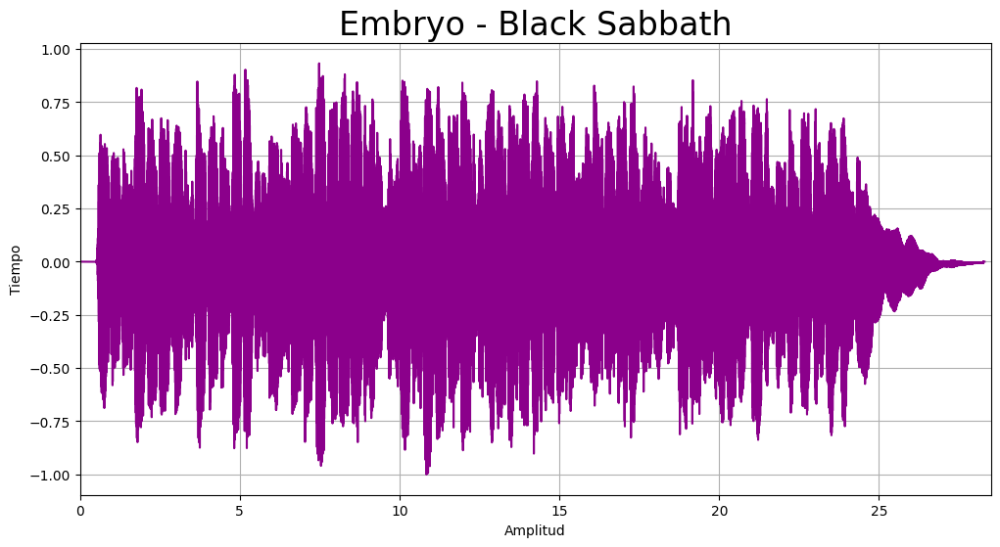

Frecuencia de muestreo:  44100
Frecuencia máxima de la señal:  22050.0
Longitud de la señal:  1248256


In [ ]:
'''

Embryo - Black Saabth

El audio fue previamente convertido de estéreo a mono

'''

# Lectura del audio
audio = ("/content/embryo.wav")
fs, x = read(audio)
fmax = fs / 2 # Por teorema de nyquist
signal1 = (x / np.max(np.abs(x)))  # Normalización de la señal

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

# Gráfica
plt.figure(figsize=(12, 6))
plt.plot(t, signal1, '#8B008B')
plt.title("Embryo - Black Sabbath", fontsize = 24)
plt.ylabel("Tiempo")
plt.xlabel("Amplitud")
plt.xlim(0, 28.5)
plt.grid()
plt.show()

# Variables
print("Frecuencia de muestreo: ", fs)
print("Frecuencia máxima de la señal: ", fmax)
print("Longitud de la señal: ", len(signal1))

# Escuchar el audio
Audio(signal1, rate=fs)

## 2. Hacer un análisis en frecuencia (FFT, espectrograma) que muestre los rangos de frecuencias en los que se distribuye la señal

### Espectro de frecuencias con FFT

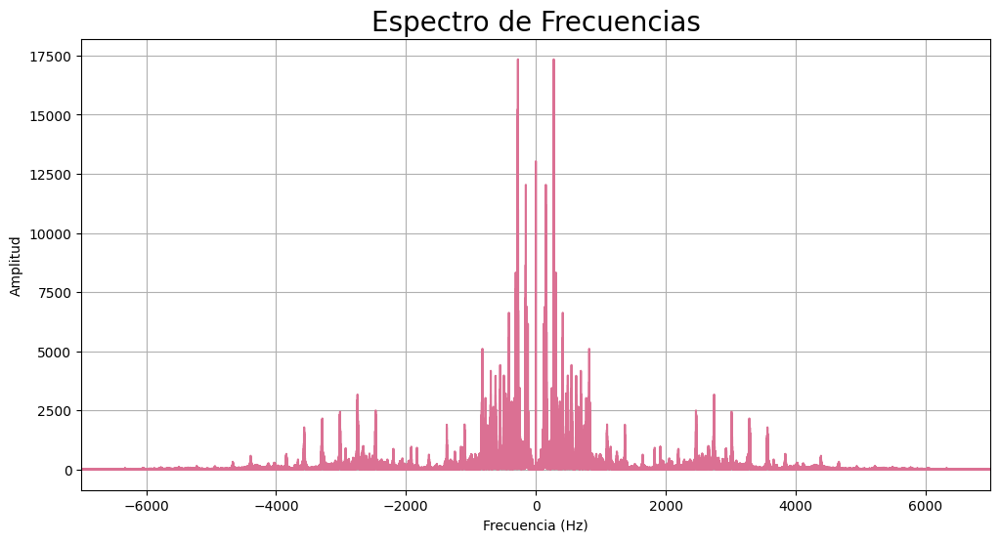

In [ ]:
'''
Análisis en Frecuencia con Fourier
'''

# Calcular la DFT
dft_signal = np.fft.fft(signal1)

# Calcular las frecuencias para el eje x
freqs = np.fft.fftfreq(len(signal1), 1/fs)

# Reordenar las frecuencias y la DFT
freqs_shifted = np.fft.fftshift(freqs)
dft_signal_shifted = np.fft.fftshift(dft_signal)

# Graficar el espectro de frecuencias
plt.figure(figsize=(12, 6))
plt.plot(freqs_shifted, np.abs(dft_signal_shifted), '#DB7093')
plt.title("Espectro de Frecuencias", fontsize = 20)
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Amplitud")
# plt.xlim(-fs/2, fs/2)
plt.xlim(-7000, 7000)
plt.grid()
plt.show()


### Espectrograma

In [ ]:
# Espectrograma

'''
También llamado enventanado y es el proceso mediante el cual se segmenta una señal en N ventanas para luego aplicarle la STFT.
Use la función mostrada a continuación y segmente su señal con un tamaño de ventana de 40 ms.
Para este punto elija solo una de las dos señales.
'''

vent = extraer_ventanas(signal1, int(0.04 * fs), fs)
vent.shape # (filas, columnas)

'''
Se aplica la ventana de Hamming a cada una de las ventanas extraídas para reducir
fugas espectrales y poder tener una mejor resolución en frecuencia de la trasnformada
'''

ham = np.hamming(int(0.04 * fs)) # Construyo la ventana con un tamaño de 40ms x fs

apply =  np.array([ventana* ham for ventana in vent])

apply.shape

(2826, 1764)

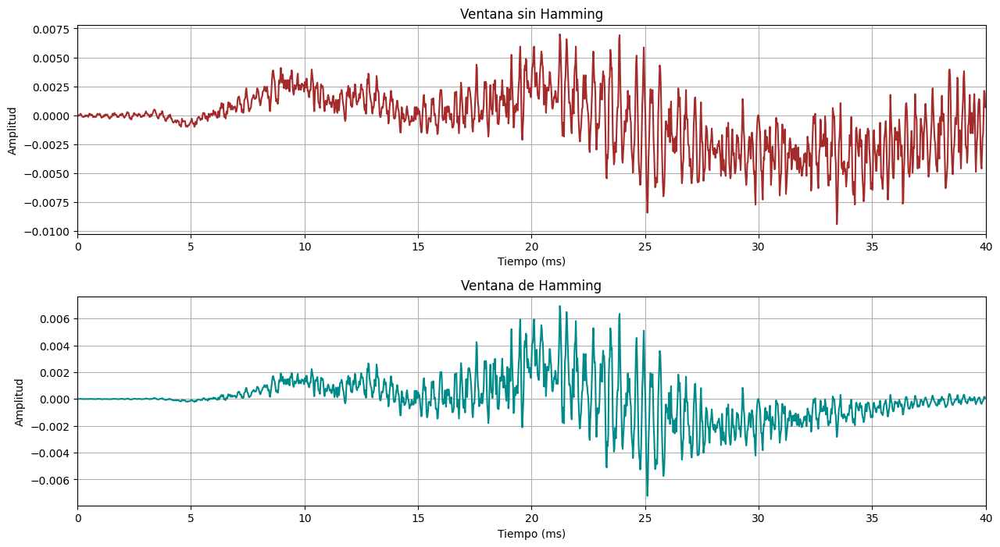

In [ ]:
t =  np.arange(0, 40 , 40/(0.04 * fs)) # Vector de tiempo

# Gráfica
plt.figure(figsize =(15,8))

plt.subplot(2, 1, 1)
plt.plot(t, vent[50], '#A52A2A')
plt.xlabel("Tiempo (ms)")
plt.ylabel("Amplitud")
plt.title('Ventana sin Hamming')
plt.xlim(0, 40)
plt.grid()

plt.subplots_adjust(hspace = 0.3)

plt.subplot(2, 1, 2)
plt.plot(t , apply[50], '#008B8B')
plt.xlabel("Tiempo (ms)")
plt.ylabel("Amplitud")
plt.title('Ventana de Hamming')
plt.xlim(0, 40)
plt.grid()

plt.show()

<ipython-input-12-cad0cc1ff0dc>:4: RuntimeWarning: divide by zero encountered in log10
  espectro = np.flipud(10*np.log10(espectro).T) # Se invierte el espectro y se pone en escala logarítmica


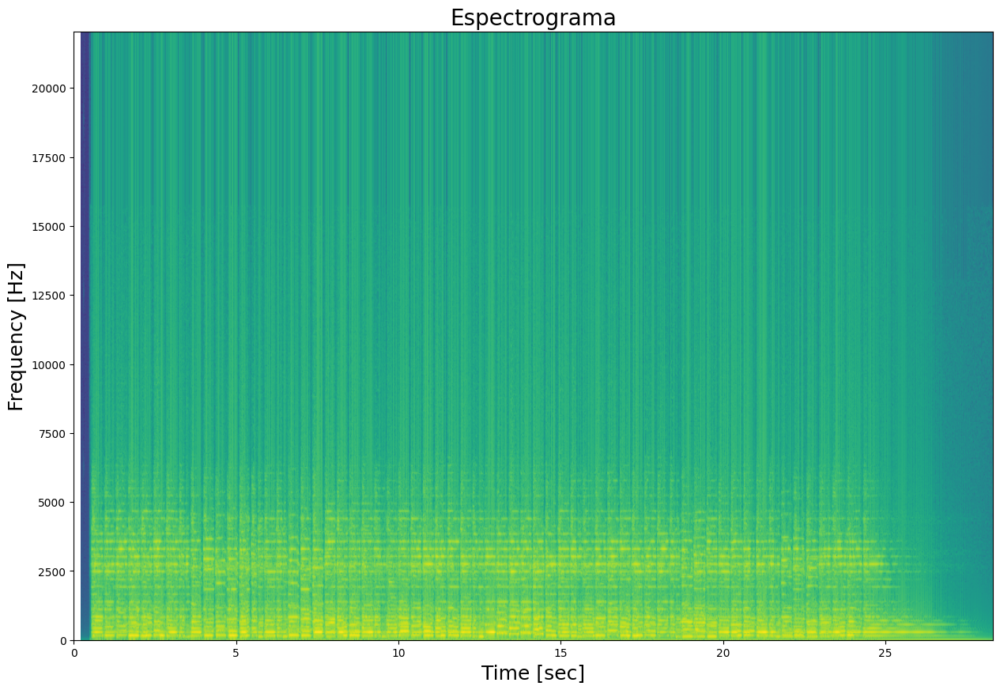

In [ ]:

potspec(apply, 1764, 1024); # matriz de ventanas, tamaño de las ventanas, tamaño de la FFT

espectro, nfft = potspec(apply, 1764, 1024) # Calcula la PSD de cada ventana de la matriz
espectro = np.flipud(10*np.log10(espectro).T) # Se invierte el espectro y se pone en escala logarítmica


# Gráfica
plt.figure(figsize=(15, 10))
plt.title('Espectrograma', fontsize = 20)
plt.imshow(espectro, aspect ='auto', extent = [0, len(x)/fs, 0, fs//2])
plt.ylabel('Frequency [Hz]', fontsize = 18)
plt.xlabel('Time [sec]', fontsize = 18)
plt.show()

### Conclusiones del análisis en frecuencia

El guitarrista de Black Sabbath, Tony Iommi, tensó las cuerdas de su guitarra tras tener un accidente con los dedos con los que tocaba, esto ocasionó un sonido más agudo propio de la banda, que se relacionan con frecuencias más altas en sus canciones.
Embryo en particular, es una pieza o riff que cuenta únicamente con el solo de guitarra de Iommi.

"It's just Tony's guitar. He plays the D string and an open high E"

Y teniendo en cuenta que las frecuencias de una guitarra abarcan el rango de 80 a 3500 Hz, se observa que la señal abarca este rango e incluso más, alcanzando picos incluso por encima de los 3500 Hz.

En el espectrograma también se observa la acumulación de energía desde las más bajas frecuencias hasta incluso los 5000 Hz. El espectrograma abarca desde 0 Hz hasta 22050 Hz que es el máximo por teorema de nyquist.

## 3. Realizar los cálculos teóricos del diseño de los filtros (apoyarse en Python para el cálculo de los coeficientes del filtro). Utilizar diferentes filtros (mínimo 3) para que obtengan diferentes tonos de la señal de audio

El diseño de los filtros se hará al rededor de los rangos de frecuencias 80 a 800 Hz, así como al rededor de 3500 Hz, ya que este es el límite superior del rango de frecuencias para una guitarra eléctrica.

El diseño de los filtros se hará por enventanado, tomando las cuatro ventanas: Hamming, Hanning, Rectangular y BlackMan.

Primero se calcula hn no causal, se lleva a causal y se multiplica por la ventana elegida (ambos causales).

Los parámetros para el diseño de los filtros son:


- Frecuencia de muestreo de la señal

$ f_s ≥ 2f_{máx}$

- Frecuencia de corte

$ \omega_c = \frac{2\pi f_c}{f_s}$

- Ripple (% de las variaciones en la banda pasante y atenuada)

$ 20log_{10}(\delta) (dB) $

- Ancho de banda de transición requerida (cómo de rápido o lento el filtro pasa de permitir a atenuar las señales)

$ \Delta\omega_w = \frac{2\pi \Delta f_n}{f_s}$

- Ancho de banda de la ventana

$\Delta \omega = \frac{8 \pi}{M} $

- Lado del filtro (se sugiere impar)

$  \Delta \omega  ≤ Δ ω_n $

In [37]:
mag = np.abs(dft_signal) # Cálculo de la magnitud del espectro

max_index = np.argmax(mag) # Cálculo del índice de magnitud máxima

max_freq = freqs[max_index] # Cálculo de la frecuencia correpondiente al índice

print("Frecuencia con mayor magnitud: ", max_freq, "Hz")

Frecuencia con mayor magnitud:  275.78044888228055 Hz


### Diseño de un filtro FIR pasa-bajas


Permite el paso de las frecuencias más bajas y atenúa las frecuencias más altas.

In [38]:
fc = max_freq # Frecuencia de corte
fw = 600
ripple1 = 0.004 # 4%

M1 = orden_filtro(fw, fs, 'Hamming') # Orden del filtro

vector1 = np.arange(-(M1-1)/2,(M1-1)/2 + 1) # Vector n

hn1 = filtro(fs, fc, fc, vector1, 'pasabajas') # Respuesta al impulso de la función sinc

wn1 = ventana(M1, 'Hamming') # Respuesta al impulso de la ventana escogida

hn1 = hn1 * wn1 # Obtengo la respuesta del filtro con el truncamiento

rip1 = calc_rip(ripple1)


print("Orden del filtro pasa-bajas: ", M1)
print("Ripple: ", rip1)

Orden del filtro pasa-bajas:  295
Ripple:  -47.95880017344075


In [ ]:
N = 1024 # Número de puntos de la FFT

w1, H1  = signal.freqz(hn1, 1, whole = True, worN = N) # Respuesta en frecuencia del filtro enventanado
# matriz de coeficientes del filtro
# coeficientes del denominador del filtro (1 para FIR, no hay feedback)
# Indica que la función debe calcular la respuesta en frecuencia en el rango completo de frecuencias
# Especifica el número de puntos en los que se evaluará la respuesta en frecuencia

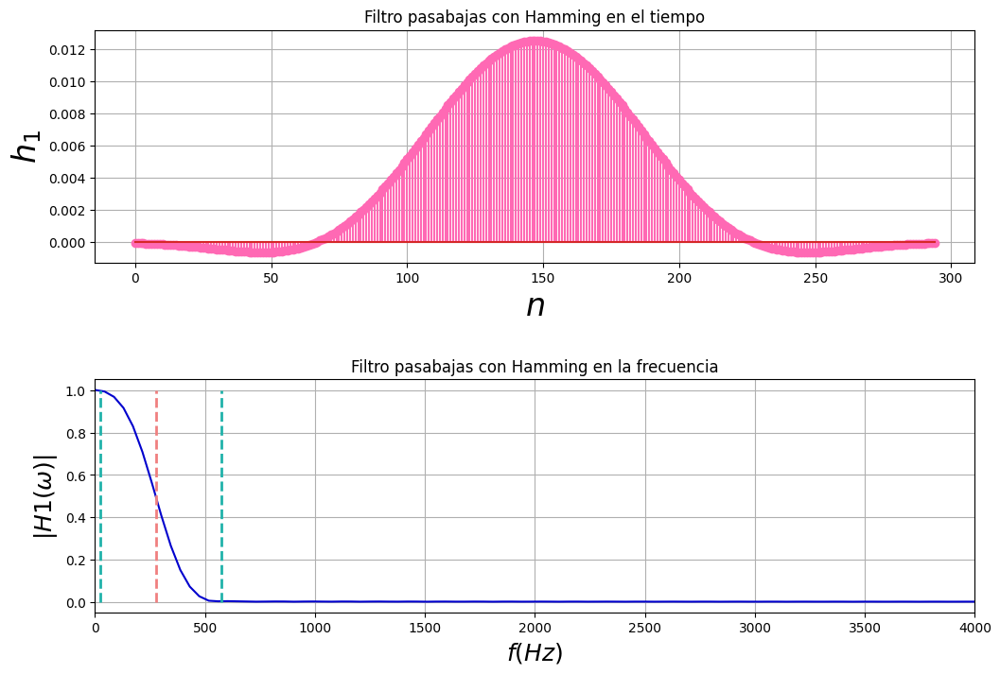

In [ ]:
# Gráficas
plt.figure(figsize =(12, 8))

# Tiempo
plt.subplot(2, 1, 1)
plt.stem(vector1 + ((M1-1)/2), hn1, '#FF69B4')
plt.title("Filtro pasabajas con Hamming en el tiempo")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_1$",fontsize=24)
plt.grid()

plt.subplots_adjust(hspace = 0.5)

# Frecuencia
plt.subplot(2, 1, 2)
plt.plot((w1 - np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(H1)), '#0000CD')
plt.vlines([-fc,fc],0,1,color='#F08080', lw=2.,linestyle='--')
plt.vlines([-fc - fw/2, -fc+fw/2,fc-fw/2 ,fc+fw/2],0,1,color='#20B2AA',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Filtro pasabajas con Hamming en la frecuencia")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H1(\omega)| $",fontsize=18)
plt.xlim(0, 4000)
plt.grid()

A menor ancho de banda (fw en Hz), mayor orden del filtro y por ende, mayor uso de coeficientes.

En frecuencia, un menor ancho de banda influye en cambios menos suaves en la pendiente del filtro.

In [ ]:
# Aplicación del filtro a la señal

yn1 = np.convolve(hn1, signal1, mode = "same")
Y1 = np.fft.fft(yn1)
Y1_freq=  np.fft.fftfreq(len(Y1))*fs


print("Embryo filtrada con pasa-bajas")
Audio(yn1, rate = fs)

Embryo filtrada con pasa-bajas


Efectivamente se escucha cómo se atenúan las frecuencias altas y se deja un sonido que denota solo frecuencias bajitas o menores a fc.


### Diseño de un filtro FIR pasa-altas

Permite el paso de las frecuencias más altas y atenúa las frecuencias más bajas.

In [ ]:
fc = 3000 # Frecuencia de corte
fw = 500
ripple2 = 0.005 # 5%

M2 = orden_filtro(fw, fs, 'Hanning') # Orden del filtro

vector2 = np.arange(-(M2-1)/2,(M2-1)/2 + 1) # Vector n

hn2 = filtro(fs, fc, fc, vector2, 'pasaaltas') # Respuesta al impulso de la función sinc

wn2 = ventana(M2, 'Hanning') # Respuesta al impulso de la ventana escogida

hn2 = hn2 * wn2 # Obtengo la respuesta del filtro con el truncamiento

rip2 = calc_rip(ripple2)

print("Orden del filtro pasa-altas: ", M2)
print("Ripple: ", rip2)

Orden del filtro pasa-altas:  353
Ripple:  -46.020599913279625


In [ ]:
N = 1024 # Número de puntos de la FFT

w2, H2  = signal.freqz(hn2, 1, whole = True, worN = N) # Respuesta en frecuencia del filtro enventanado
# matriz de coeficientes del filtro
# coeficientes del denominador del filtro (1 para FIR, no hay feedback)
# Indica que la función debe calcular la respuesta en frecuencia en el rango completo de frecuencias
# Especifica el número de puntos en los que se evaluará la respuesta en frecuencia

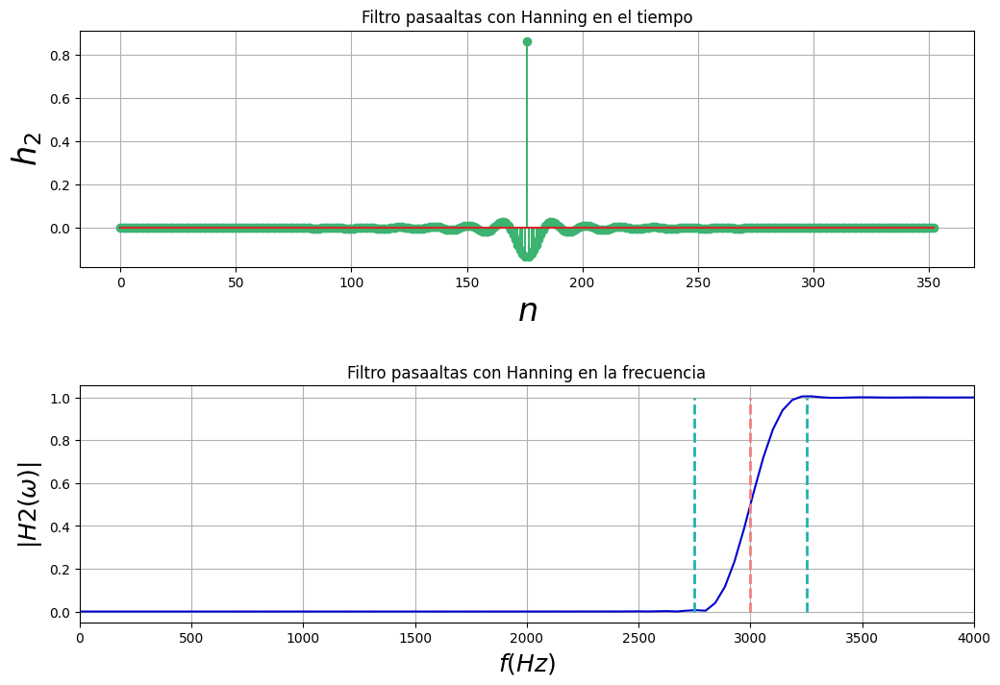

In [ ]:
# Gráficas
plt.figure(figsize =(12, 8))

# Tiempo
plt.subplot(2, 1, 1)
plt.stem(vector2 + ((M2-1)/2), hn2, '#3CB371')
plt.title("Filtro pasaaltas con Hanning en el tiempo")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_2$",fontsize=24)
plt.grid()

plt.subplots_adjust(hspace = 0.5)

# Frecuencia
plt.subplot(2, 1, 2)
plt.plot((w2 - np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(H2)), '#0000CD')
plt.vlines([-fc,fc],0,1,color='#F08080', lw=2.,linestyle='--')
plt.vlines([-fc - fw/2, -fc+fw/2,fc-fw/2 ,fc+fw/2], 0, 1, color='#20B2AA',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Filtro pasaaltas con Hanning en la frecuencia")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.xlim(0, 4000)
plt.grid()

In [ ]:
# Aplicación del filtro a la señal

yn2 = np.convolve(hn2, signal1, mode = "same")
Y2 = np.fft.fft(yn2)
Y2_freq=  np.fft.fftfreq(len(Y2))*fs


print("Embryo filtrada con pasa-altas")
Audio(yn2, rate = fs)

Embryo filtrada con pasa-altas


Efectivamente se escuchan notas por encima de casi el límite de frecuencia, reafirmando las altas frecuencias de la guitarra de Iommi debido al ajuste de sus cuerdas.

### Diseño de un filtro FIR pasa-bandas

Permite el paso de un determinado rango de frecuencias de una señal y atenúa el paso del resto.

In [ ]:
fc1 = 200 # Frecuencia de corte
fc2 = 1000
fw = 200
ripple3 = 0.0003 # 0.3%


M3 = orden_filtro(fw, fs, 'Blackman') # Orden del filtro

vector3 = np.arange(-(M3-1)/2,(M3-1)/2 + 1) # Vector n

hn3 = filtro(fs, fc1, fc2, vector3, 'pasabandas') # Respuesta al impulso de la función sinc

wn3 = ventana(M3, 'Blackman') # Respuesta al impulso de la ventana escogida

hn3 = hn3 * wn3 # Obtengo la respuesta del filtro con el truncamiento

rip3 = calc_rip(ripple3)

print("Orden del filtro pasa-bandas: ", M3)
print("Ripple: ", rip3)

Orden del filtro pasa-bandas:  1323
Ripple:  -70.45757490560675


In [ ]:
N = 1024 # Número de puntos de la FFT

w3, H3  = signal.freqz(hn3, 1, whole = True, worN = N) # Respuesta en frecuencia del filtro enventanado
# matriz de coeficientes del filtro
# coeficientes del denominador del filtro (1 para FIR, no hay feedback)
# Indica que la función debe calcular la respuesta en frecuencia en el rango completo de frecuencias
# Especifica el número de puntos en los que se evaluará la respuesta en frecuencia

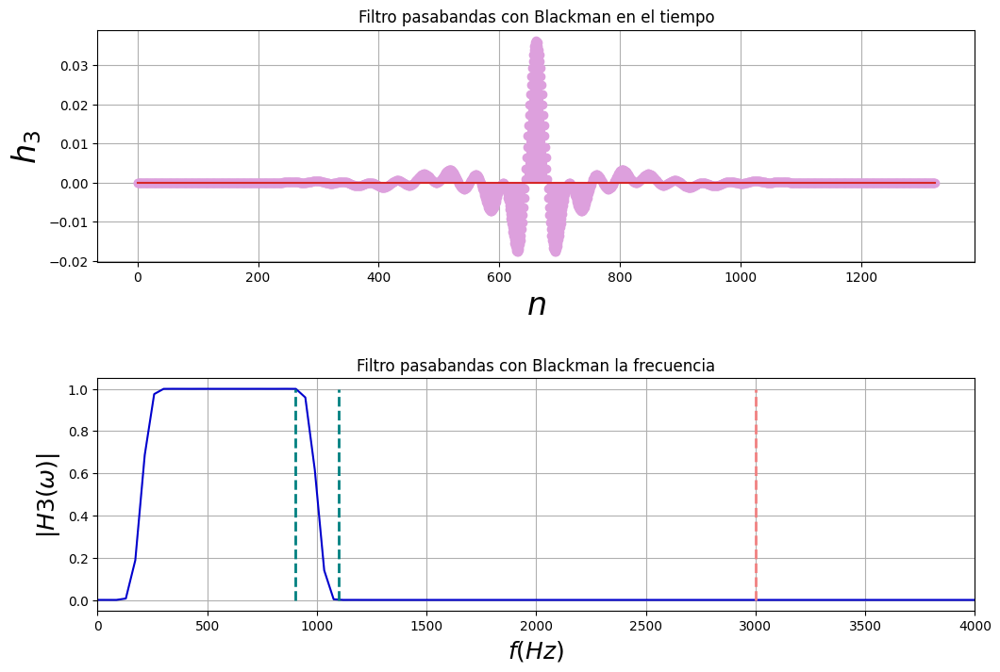

In [ ]:
# Gráficas
plt.figure(figsize =(12, 8))

# Tiempo
plt.subplot(2, 1, 1)
plt.stem(vector3 + ((M3-1)/2), hn3, '#DDA0DD')
plt.title("Filtro pasabandas con Blackman en el tiempo")
plt.xlabel("$n$",fontsize=24)
plt.ylabel("$h_3$",fontsize=24)
plt.grid()

plt.subplots_adjust(hspace = 0.5)

# Frecuencia
plt.subplot(2, 1, 2)
plt.plot((w3 - np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(H3)), '#0000CD')
plt.vlines([-fc,fc],0,1,color='#F08080', lw=2.,linestyle='--')
plt.vlines([-fc2-fw/2,-fc2+fw/2,fc2-fw/2 ,fc2+fw/2],0,1,color='#008080',lw=2.,linestyle='--')
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.title("Filtro pasabandas con Blackman la frecuencia")
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H3(\omega)| $",fontsize=18)
plt.xlim(0, 4000)
plt.grid()

In [ ]:
# Aplicación del filtro a la señal

yn3 = np.convolve(hn3, signal1, mode = "same")
Y3 = np.fft.fft(yn3)
Y3_freq=  np.fft.fftfreq(len(Y3))*fs


print("Embryo filtrada con pasa-bandas")
Audio(yn3, rate = fs)

Embryo filtrada con pasa-bandas


Se escucha el audio en un rango medianamente amplio de frecuencias, pues toman frecuencias no tan bajas (200 Hz) que incluyen la frecuencia con mayor amplitud y se tiene un límite superior de 1000 Hz que aunque es apenas un tercio de lo que una guitarra eléctrica podría alcanzar en frecuencia, denota en el audio también algunas notas agudas.

## 4. Comparar la señal original y la señal filtrada y observar sus diferencias (visualmente y mediante la correlación)


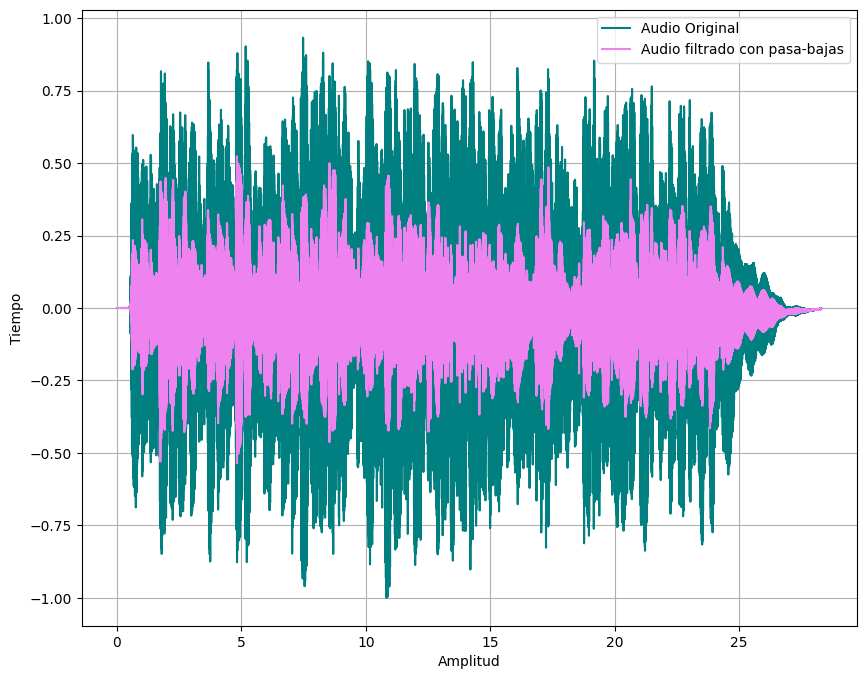

Coeficiente de correlación:  0.7872977447814927


In [ ]:
# PASA BAJAS Y SEÑAL ORIGINAL

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

# Gráficas
plt.figure(figsize=(10,8))

plt.plot(t, signal1,'#008080', label='Audio Original')
plt.plot(t, yn1,'#EE82EE', label='Audio filtrado con pasa-bajas')
plt.xlabel("Amplitud")
plt.ylabel("Tiempo")
plt.legend()
plt.grid()
plt.show()

corr1 = np.corrcoef(signal1,yn1)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-bajas
print("Coeficiente de correlación: ", corr1)

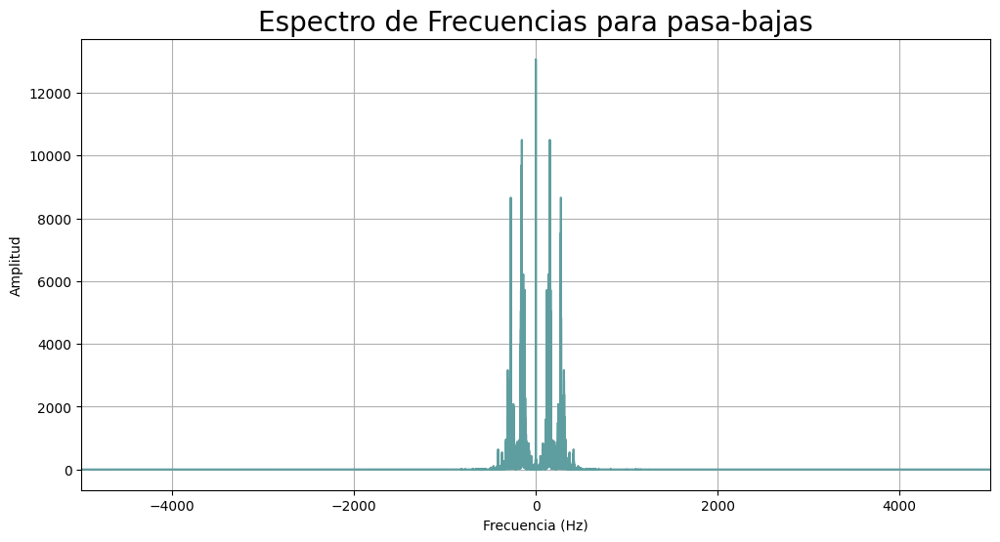

In [40]:
'''
Análisis en Frecuencia con Fourier para pasa-bajas
'''

# Calcular la DFT
dft_signal = np.fft.fft(yn1)

# Calcular las frecuencias para el eje x
freqs = np.fft.fftfreq(len(yn1), 1/fs)

# Reordenar las frecuencias y la DFT
freqs_shifted = np.fft.fftshift(freqs)
dft_signal_shifted = np.fft.fftshift(dft_signal)

# Graficar el espectro de frecuencias
plt.figure(figsize=(12, 6))
plt.plot(freqs_shifted, np.abs(dft_signal_shifted), '#5F9EA0')
plt.title("Espectro de Frecuencias para pasa-bajas", fontsize = 20)
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Amplitud")
# plt.xlim(-fs/2, fs/2)
plt.xlim(-5000, 5000)
plt.grid()
plt.show()


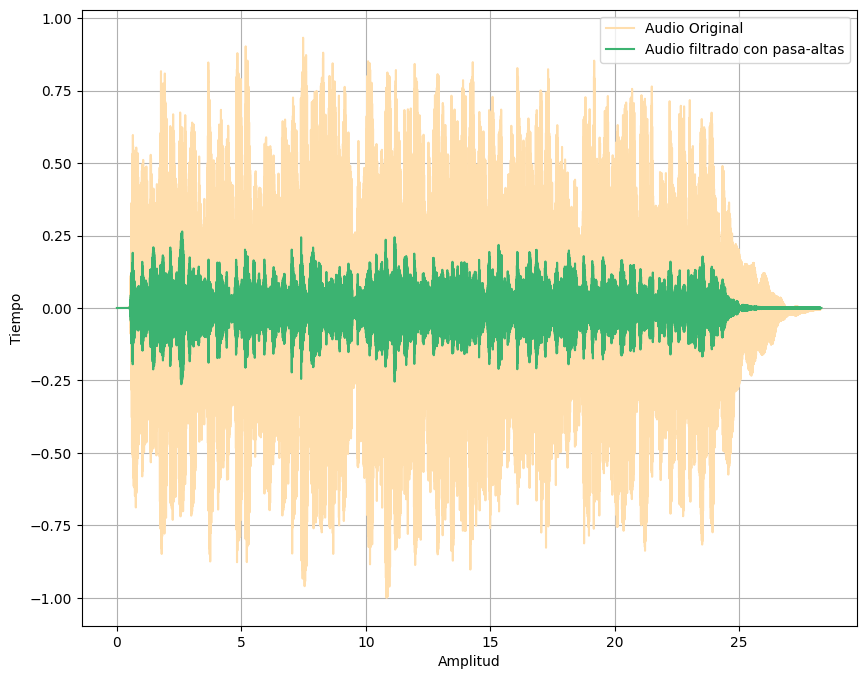

Coeficiente de correlación:  0.1878474464333806


In [ ]:
# PASA ALTAS Y SEÑAL ORIGINAL

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

# Gráficas
plt.figure(figsize=(10,8))

plt.plot(t, signal1,'#FFDEAD', label='Audio Original')
plt.plot(t, yn2,'#3CB371', label='Audio filtrado con pasa-altas')
plt.xlabel("Amplitud")
plt.ylabel("Tiempo")
plt.legend()
plt.grid()
plt.show()

corr2 = np.corrcoef(signal1,yn2)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-altas
print("Coeficiente de correlación: ", corr2)

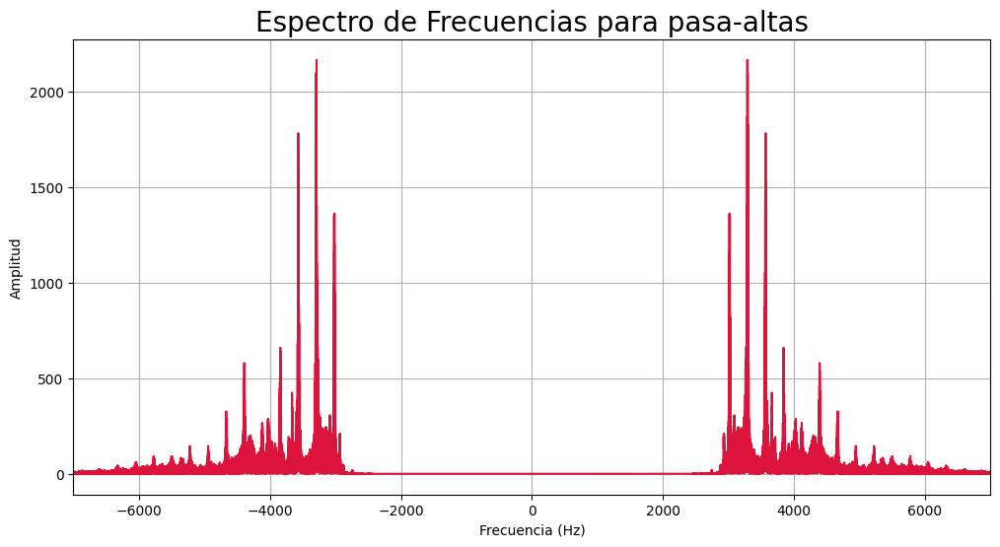

In [41]:
'''
Análisis en Frecuencia con Fourier para pasa-altas
'''

# Calcular la DFT
dft_signal = np.fft.fft(yn2)

# Calcular las frecuencias para el eje x
freqs = np.fft.fftfreq(len(yn2), 1/fs)

# Reordenar las frecuencias y la DFT
freqs_shifted = np.fft.fftshift(freqs)
dft_signal_shifted = np.fft.fftshift(dft_signal)

# Graficar el espectro de frecuencias
plt.figure(figsize=(12, 6))
plt.plot(freqs_shifted, np.abs(dft_signal_shifted), '#DC143C')
plt.title("Espectro de Frecuencias para pasa-altas", fontsize = 20)
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Amplitud")
# plt.xlim(-fs/2, fs/2)
plt.xlim(-7000, 7000)
plt.grid()
plt.show()


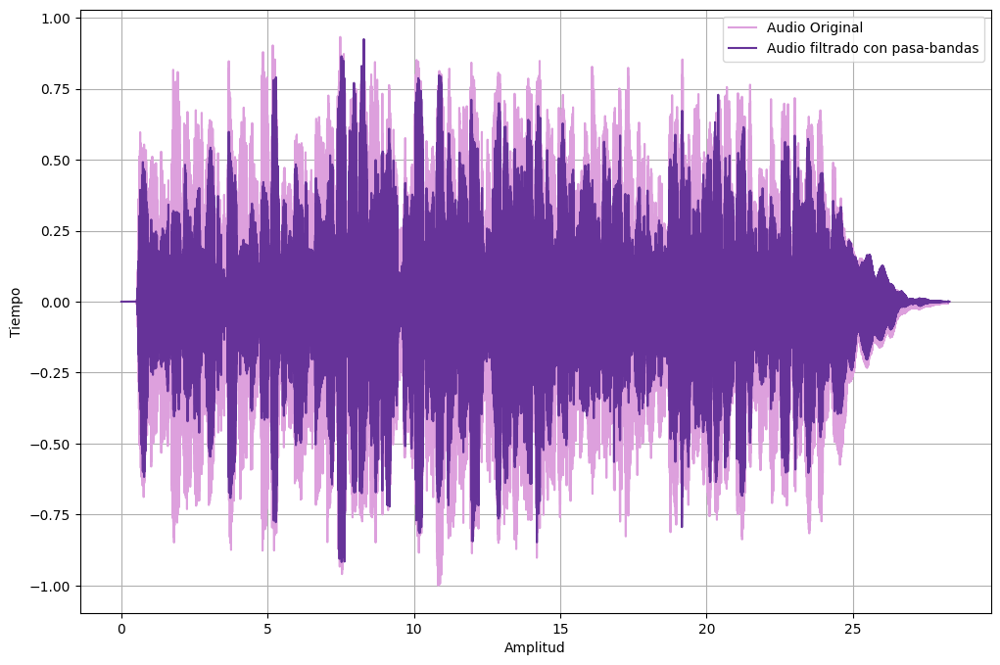

Coeficiente de correlación:  0.8116487274764179


In [42]:
# PASA BANDAS Y SEÑAL ORIGINAL

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

# Gráficas
plt.figure(figsize=(12,8))

plt.plot(t, signal1,'#DDA0DD', label='Audio Original')
plt.plot(t, yn3,'#663399', label='Audio filtrado con pasa-bandas')
plt.xlabel("Amplitud")
plt.ylabel("Tiempo")
plt.legend()
plt.grid()
plt.show()

corr3 = np.corrcoef(signal1,yn3)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-bandas
print("Coeficiente de correlación: ", corr3)

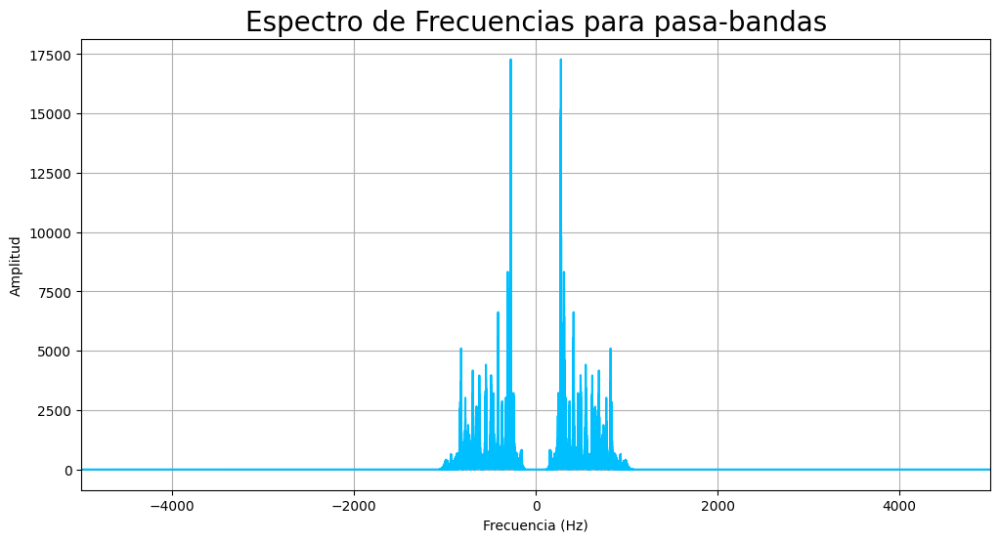

In [44]:
'''
Análisis en Frecuencia con Fourier para pasa-bandas
'''

# Calcular la DFT
dft_signal = np.fft.fft(yn3)

# Calcular las frecuencias para el eje x
freqs = np.fft.fftfreq(len(yn3), 1/fs)

# Reordenar las frecuencias y la DFT
freqs_shifted = np.fft.fftshift(freqs)
dft_signal_shifted = np.fft.fftshift(dft_signal)

# Graficar el espectro de frecuencias
plt.figure(figsize=(12, 6))
plt.plot(freqs_shifted, np.abs(dft_signal_shifted), '#00BFFF')
plt.title("Espectro de Frecuencias para pasa-bandas", fontsize = 20)
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Amplitud")
# plt.xlim(-fs/2, fs/2)
plt.xlim(-5000, 5000)
plt.grid()
plt.show()


El coeficiente de correlación es mayor para el filtro pasa-bandas, pues es este quien arroja la señal con más componentes de frecuencias, por lo que se asemeja más a la señal original.

El coeficiente de correlación para el filtro pasa-altas es el mejor, debido a que la frecuencia de corte seleccionada (3 KHz) abarca solo un pequeño porcentaje de frecuencias presentes en la señal original y suprime las demás.

El coeficiente de correlación para el filtro pasa-bajas es semejante al del filtro pasa-bandas, es alto debido a que incluye la frecuencia de mayor magnitud y las que están por debajo, por lo que para los componentes espectrales de baja frecuencia, habrá semejanza.

## 5. Realizar el filtrado usando las funciones ya definidas en Python

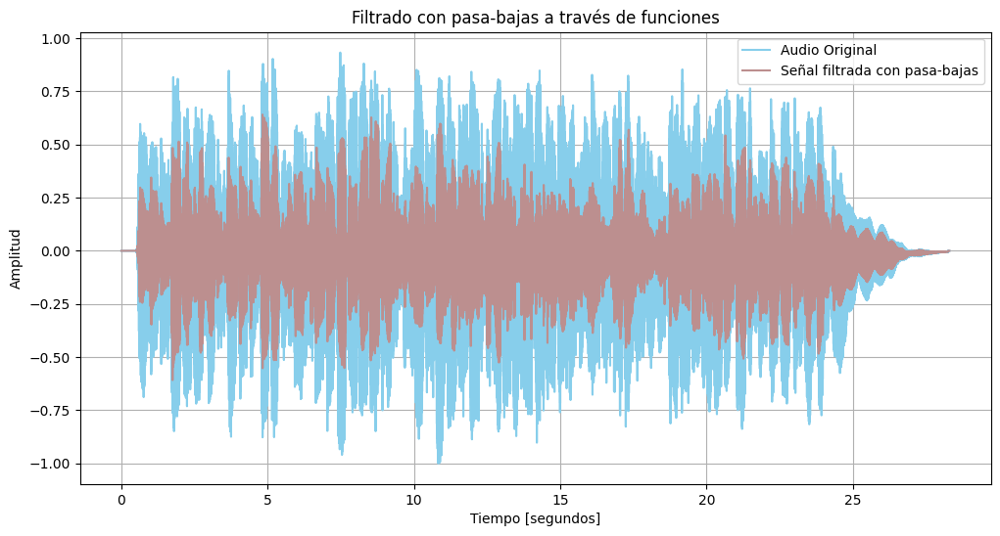

Coeficiente de correlación:  -0.3402605781824733
Embryo filtrada con pasa-bajas teórico


In [ ]:
# Filtro pasa-bajas

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs  # Frecuencia de Nyquist
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y


cutoff = max_freq # Se toma la misma frecuencia de corte

order = 5 # Orden del filtro

n = int(0.5 * fs) # Número de muestras

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

y_1 = lowpass_filter(signal1, cutoff, fs, order)

# Gráfica

plt.figure(figsize=(12, 6))
plt.title('Filtrado con pasa-bajas a través de funciones')
plt.plot(t, signal1, '#87CEEB',label='Audio Original')
plt.plot(t, y_1, '#BC8F8F' ,label='Señal filtrada con pasa-bajas')
plt.xlabel('Tiempo [segundos]')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()
plt.show()


corr4 = np.corrcoef(signal1, y_1)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-bajas usando funciones
print("Coeficiente de correlación: ", corr4)

print("Embryo filtrada con pasa-bajas teórico")
Audio(y_1, rate = fs)

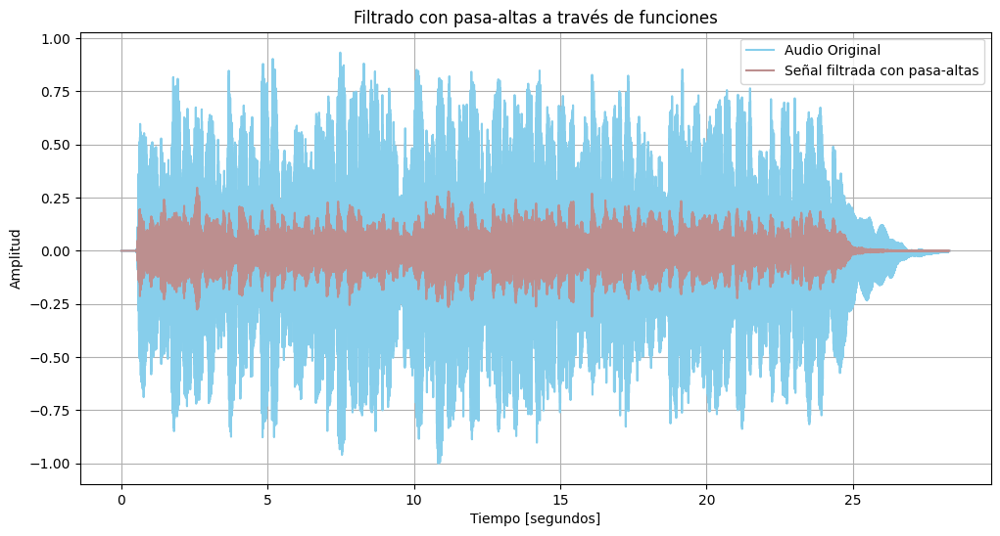

Coeficiente de correlación:  -0.24011709253660315
Embryo filtrada con pasa-altas teórico


In [ ]:
# Filtro pasa-altas

def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs  # Frecuencia de Nyquist
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def highpass_filter(data, cutoff, fs, order=5):
    b, a = butter_highpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y


cutoff = 3000 # Se toma la misma frecuencia de corte

order = 4 # Orden del filtro

n = int(0.5 * fs) # Número de muestras

t =  np.arange(0,float(len(x))/fs,1.0/fs) # Vector de tiempo

y_2 = highpass_filter(signal1, cutoff, fs, order)

# Gráfica

plt.figure(figsize=(12, 6))
plt.title('Filtrado con pasa-altas a través de funciones')
plt.plot(t, signal1, '#87CEEB',label='Audio Original')
plt.plot(t, y_2, '#BC8F8F' ,label='Señal filtrada con pasa-altas')
plt.xlabel('Tiempo [segundos]')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()
plt.show()

corr5 = np.corrcoef(signal1, y_2)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-altas usando funciones
print("Coeficiente de correlación: ", corr5)

print("Embryo filtrada con pasa-altas teórico")
Audio(y_2, rate = fs)

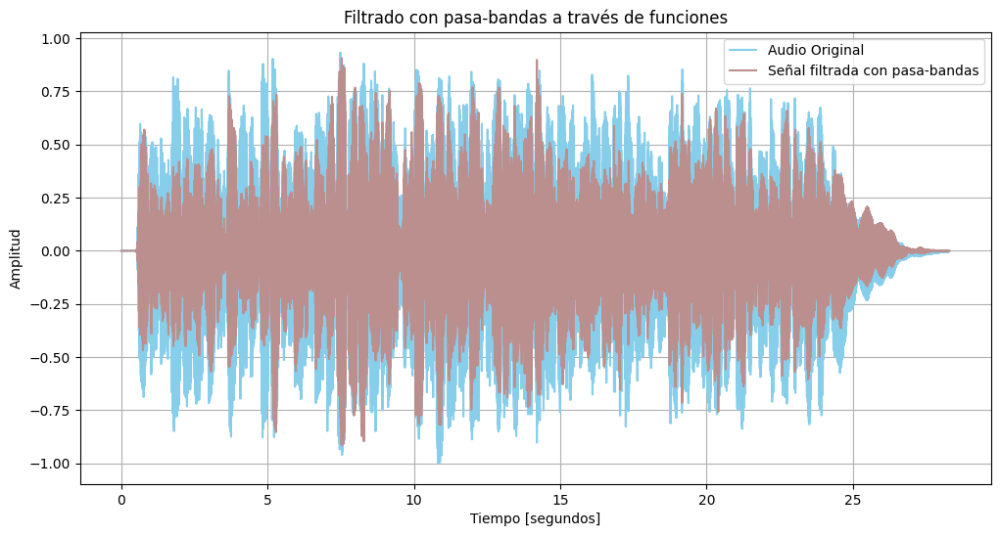

Coeficiente de correlación:  0.15108034389626146
Embryo filtrada con pasa-bandas teórico


In [ ]:
# Filtro pasa-bandas

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs  # Frecuencia de Nyquist
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

lowcut = 200 # Frecuencia de corte 1
highcut = 1000 # Frecuencia de corte 2

y_3 = bandpass_filter(signal1, lowcut, highcut, fs, order)


# Gráfica

plt.figure(figsize=(12, 6))
plt.title('Filtrado con pasa-bandas a través de funciones')
plt.plot(t, signal1, '#87CEEB',label='Audio Original')
plt.plot(t, y_3, '#BC8F8F' ,label='Señal filtrada con pasa-bandas')
plt.xlabel('Tiempo [segundos]')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()
plt.show()

corr6 = np.corrcoef(signal1, y_3)[0, 1] # Coeficiente de correlación entre la señal original y la filtrada con pasa-bandas usando funciones
print("Coeficiente de correlación: ", corr6)

print("Embryo filtrada con pasa-bandas teórico")
Audio(y_3, rate = fs)

Los audios tras ser filtrados a través de las funciones propias de python, se escuchan muy semejantes a los filtrados a través de cálculos explícitos.

Los coeficientes de correlación no coinciden de la forma en la que lo hacen con los filtros teóricos, esto se podría deber a la ausencia del enventanado en la aplicación de las funciones.

Otro factor importante es el orden del filtro, en los calculados teóricamente en el punto 3 y 4, se implementan órdenes de incluso cientos, mientras que con estos se implementan valores que no superen una decena para evitar que la señal se pierda.

## 6. Comparar el diseño teórico y el diseño con las funciones en Python de los diferentes filtros (Utilizar la correlación para comparar las señales).


In [ ]:
corr_low = np.corrcoef(yn1, y_1)[0, 1] # Coeficiente de correlación entre filtros pasa-bajas

corr_high = np.corrcoef(yn2, y_2)[0, 1] # Coeficiente de correlación entre filtros pasa-altas

corr_band = np.corrcoef(yn3, y_3)[0, 1] # Coeficiente de correlación entre filtros pasa-bandas

print("Coeficiente de correlación entre filtros pasa-bajas: ", corr_low)

print("Coeficiente de correlación entre filtros pasa-altas: ", corr_high)

print("Coeficiente de correlación entre filtros pasa-bandas: ", corr_band)

Coeficiente de correlación entre filtros pasa-bajas:  -0.38907463974054535
Coeficiente de correlación entre filtros pasa-altas:  -0.6735561820814221
Coeficiente de correlación entre filtros pasa-bandas:  0.2367347648925468


##Conclusiones

- Al comienzo del procesamiento, había un problema en la implementación de una función para escuchar el audio, se estaba usando la función Audio que solo permite una dimensión de datos y al tener una señal con dos canales (estéreo) se tenía un arreglo de dos dimensiones, por lo que asegurarse del formato mono para una señal si se implementará esta función, permitirá una correcta lectura de la misma.

- El diseño de filtros por los diferentes métodos arrojó resultados similares y bastante acordes a lo esperado, aunque cada método presenta sus ventajas: el filtrado a través de las funciones de python es sencillo y eficiente, mientras que el filtrado teórico permite ajustar más parámetros a conveniencia, tal como el tipo de ventana, el ripple y el ancho de banda de transición. También se da cuenta de limitantes del filtrado a través de funciones, órdenes grandes no funcionan y de hecho anulan la señal, mientras que en el apartado teórico, se jugó con el orden de los filtros sin tener este tipo de problemas.

- Es importante contar con diferentes herramientas para el análisis de frecuencias según el origen de la señal, en este caso fue suficiente con un análisis espectral usando Fourier para visualizar magnitudes y frecuencias, pero para otras aplicaciones que por ejemplo, puedan incluir la necesidad de detección de patrones se haría necesario implementar otras herramientas tales como espectrogramas. Este último también se implementó en la práctica y confirmó los resultados presentados en el análisis de Fourier.

- Conocer la naturaleza de la señal permite escoger objetivamente frecuencias de corte para detallar más características puntuales que sean importantes en la misma y evitar omitirlas. En este caso, se conocía la naturaleza de las frecuencias en el espectro para el audio y con base a ello, se realizó un mejor análisis al obtener las respuestas de los filtros.